# TTT4185 Machine learning for Speech technology

## Voluntary computer assignment 1: Speech analysis

This assignment assumes that the student has knowledge about short-time spectral estimation, linear prediction modeling and cepstral analysis. You should also know the concept of fundamental frequencies and formants.

Useful commands include `matplotlib.pyplot.plot`.

### Problem 1

In this problem we will look at a speech signal and do simple spectral analysis on the signal.

(a) Download the speech file `stry.wav` from Blackboard and load the file using `scipy.io.wavefile.read`. The speech represents the latter half of the English word "tapestry". The phonetic transcription is /s/ /t/ /r/ /iy/.
- Plot the signal.
- What is characteristic about the sounds /s/, /t/, /r/ and /iy/?
- Take a 40 millisecond subset of the vowel /iy/ and plot it.
- Find the fundamental frequency $F_0$ of the vowel.

#### Plot of the signal

(7438,)


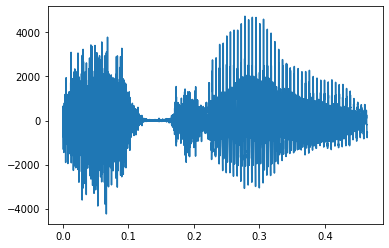

In [296]:
import scipy.io.wavfile
import numpy as np
import matplotlib.pyplot as plt

Fs, data = scipy.io.wavfile.read('stry.wav')
print(data.shape)
plt.plot(np.arange(data.shape[0]) / Fs, data)

The vowels differ in their formants, i.e. the peaks in their frequency responses. However, it gets more complicated for the consonants. Since they are made up by disturbances to the vocal tract, they may also show a time varying spectrogram. But overall, one can say that all sounds consists of a fundamental frequency which gets passed through a (possibly time-varying) filter. And the filter is characteristic for the different sounds.

### 40 ms plot of the /iy/ vowel (the last 40ms):

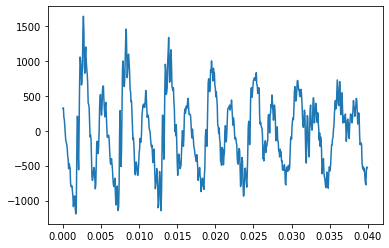

In [298]:
num_samples_iy = int(Fs * 40e-3)
samples_iy = data[ -num_samples_iy : ]
plt.plot(np.arange(num_samples_iy) / Fs, samples_iy)

We count 7 full cycles of the oscillations with the larges amplitude in the signal above. The fundamental frequency is then easily found as follows:

$$
    F_0 = 7 / (40E-3) \approx 175 [Hz]
$$

(b) Spectral analysis
- Estimate the spectrum of the vowel using an FFT of length 1024. Plot the log-spectrum as a function of frequency
- Multiply the signal by a Hamming window and repeat the last operation.
- Explain the difference between the two spectra.
- Estimate the fundamental frequency $F_0$ using the spectrum, and compare the result to what you got in 1a)
- Roughly estimate the two first formant frequencies.

Useful Python functions: `numpy.fft.fft`, `numpy.abs`, `scipy.signal.hamming`.

The spectrum of the signal is plotted below with log-scale on the y-axis.

We count 6 peaks in the frequency spectrum within 1000Hz. This means that the fundamental frequency $F_0 = 1000/6 \approx 167Hz$. This matches well with what we found visual inspection of the signal above.

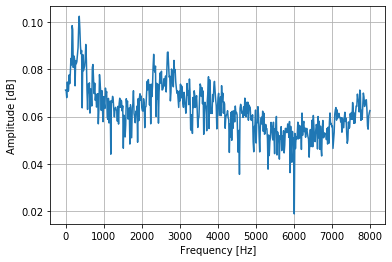

In [300]:
fft_length = 1024
spectrum = np.fft.fft(samples_iy, n=fft_length)

frequencies = np.linspace(0.0, Fs/2.0, fft_length//2)
amplitudes = 20/fft_length * np.log10(np.abs(spectrum[0:fft_length//2]))

plt.ylabel("Amplitude [dB]")
plt.xlabel("Frequency [Hz]")
plt.grid()
plt.plot(frequencies, amplitudes)

I have plotted the same spectrum with a hamming window applied below. By comparing the spectra, we see that the one with the hamming window contains less high frequency components. This is the beauty of the hamming window; since it weighs samples almost like a bell curve within the FFT window, we do not get sharp cutoffs near the edges. Thus, we get rid of high frequency components which actually is just noise.

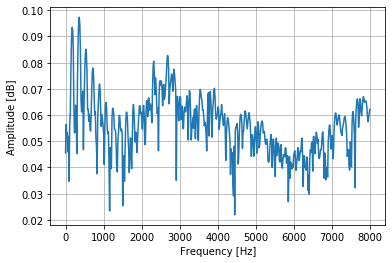

In [302]:
import scipy.signal
fft_length = 1024
hamming_window = scipy.signal.hamming(num_samples_iy)
samples_hamming = samples_iy * hamming_window
spectrum = np.fft.fft(samples_hamming, n=fft_length)

frequencies_hamming = np.linspace(0.0, Fs/2.0, fft_length//2)
amplitudes_hamming = 20/fft_length * np.log10(np.abs(spectrum[0:fft_length//2]))

plt.ylabel("Amplitude [dB]")
plt.xlabel("Frequency [Hz]")
plt.grid()
plt.plot(frequencies_hamming, amplitudes_hamming)

It is a little bit difficult to find the formants by merely inspecting the spectrum. But I would say that the first formant lies around 300Hz, and the second one around 2700Hz. The way we find these are by visualizing the underlying shape of the spectrum, and localizing the first two maxima.

(c) AR modeling
- Compute the coefficients of an AR model (linear prediction coefficients) with order 4, 8, 16 and 50, based on the vowel.
- Estimate the spectrum for each of the model orders. Plot the log-spectrum as a function of frequency.
- Compare your results with the spectrum from 1b). Which model order yields the "best" spectral envelope? What happens if the model order is too high or too low?
- Why is it impossible to estimate the fundamental frequency based on the LP model?

Useful Python functions: `pysptk.sptk.lpc`, `scipy.signal.freqz`.

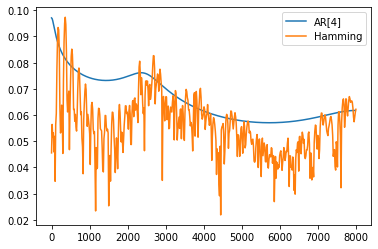

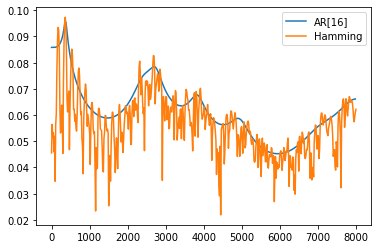

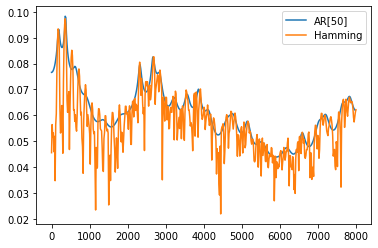

In [303]:
import pysptk.sptk
import scipy.signal
frequencies_ar = []
amplitudes_ar = []
for order in [4, 16, 50]:
    lpc_coeffs = pysptk.sptk.lpc(samples_hamming, order)
    frequencies, spectrum = scipy.signal.freqz([lpc_coeffs[0]], np.concatenate(([1], lpc_coeffs[1:])), fs=Fs)
    amplitudes = 20/1000*np.log10(np.abs(spectrum))

    frequencies_ar.append(frequencies)
    amplitudes_ar.append(amplitudes)

    plt.plot(frequencies, amplitudes, label=f'AR[{order}]')
    plt.plot(frequencies_hamming, amplitudes_hamming, label="Hamming")
    plt.legend()
    plt.show()

I would say that the AR model of order 16 yields the best spectral envolope. The one of order 4 does not capture the shape of the filter well enough, whereas the one of order 50 includes the disturbances (i.e. the fundamental frequency). The one of order 16 includes all formants.

It is impossible to estimate the fundamental frequency simply because the AR model models the filter, and not the disturbance. It tries to isolate the vocal tract from the fundamental frequency.

(d) Use `scipy.signal.spectrogram` to create a spectrogram of the entire speech signal. Try to generate both wide- and narrow-band spectrograms by adjusting the window lengths and overlaps. Which characteristic traits of the speech sounds /s/, /t/, /r/ and /iy/ can you see from the spectrogram?

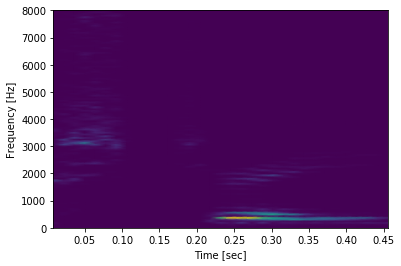

In [295]:
import scipy.signal
f, t, Sxx = scipy.signal.spectrogram(data, fs=Fs)
plt.pcolormesh(t, f, Sxx, shading='gouraud')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.show()

**/s/**: Has a lot of different formants. We also see that the lips plays an important role in making the sound, since there are lots of disturbances. It also operates in a large bandwidth. Consists mainly of frequencies around 3k-4k

**/t/**: Has a much smaller bandwidth, but the same disturbances which comes from the lips. Also it takes a lot less time, because it is made by a build-up in pressure before quickly releasing it. Frequencies around 3k.

**/r/**: Has mainly two formants sub-1k. But we observe oscillations around 2k-3k in time, which makes sense.

**/iy/**: In the transition from /r/ to /iy/, the oscillations disappears gradually, and the highest of the two formants vanishes, leaving mainly one large formant around 3k.

### Problem 2
In this problem we look at the cepstrum and deconvolution

(a) Compute and plot the real cepstrum of the vowel from problem 1a).

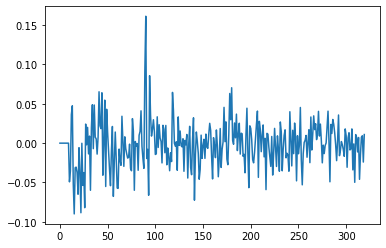

In [297]:
import scipy.signal
spectrum = np.fft.fft(samples_iy)
spectrum_ln = np.log(np.abs(spectrum))
cepstrum_symmetric = np.fft.ifft(spectrum_ln)
n = cepstrum_symmetric.shape[0]
cepstrum = np.concatenate(([0 for i in range(10)], cepstrum_symmetric[10: int(n/2)]))
plt.plot(cepstrum)

(b) Use the cepstrum to compute the fundamental frequency $F_0$. Compare your results with those obtained in problem 1).

In [299]:
fundamental_frequency = int(Fs/np.argmax(cepstrum))
print("fundamental_frequency: %sHz" % fundamental_frequency)

fundamental_frequency: 177Hz


(c) In this subproblem you will use the cepstrum to estimate the spectral envelope
- Use liftering to extract the part of the ceptrum that represents the spectral envelope.
- Plot the spectral envelope as a function of frequency, and compare the result with the results from problem 1).

Hint 1: Remember that the cepstrum of a real signal is symmetric, so the liftered signal mus be symmetric as well.

Hint 2: The FFT of a real, symmtric signal is real, but due to round-off errors small imaginary noise may occur. Use `np.real` to get to the real part of the liftered log-spectrum.

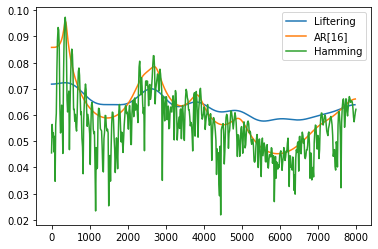

In [301]:
envelope = cepstrum_symmetric
envelope[16:len(envelope)-16] = 0
spectrum_envelope = np.abs(np.exp(np.fft.fft(envelope, n=620)))
frequencies_envelope = np.fft.fftfreq(620, d=1/Fs)

frequencies_envelope = frequencies_envelope[ :frequencies_envelope.shape[0]//2]
spectrum_envelope = spectrum_envelope[ :spectrum_envelope.shape[0]//2]
amplitudes_envelope = 20 / 1024 * np.log10(spectrum_envelope[:num_samples_iy])

plt.plot(frequencies_envelope, amplitudes_envelope, label="Liftering")
plt.plot(frequencies_ar[1], amplitudes_ar[1], label="AR[16]")
plt.plot(frequencies_hamming, amplitudes_hamming, label="Hamming")
plt.legend()

Above, the spectral envelope resulting from liftering is plotted together with the best AR model (AR[16]) and the standard hamming. We see that both models capture the formants quite accurately when tuned correctly. However, there are some differences; liftering indicates a subtle formant around 6kHz - which AR fails to capture. Also, AR[16] is better at capturing the overall shape better than the AR model.